In [ ]:
import torchvision.transforms as T
import numpy as np
import os
import torch
from common import *
from matplotlib import pyplot as plt
import plotly.graph_objects as go
import plotly.io as pio
import PIL
import PIL.Image
import cv2
from kemsekov_torch.positional_emb import PositionalEncodingPermute
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.ndimage import affine_transform
import random
import skimage.measure



In [ ]:

class GeneratedDataset(torch.utils.data.Dataset):
    def __init__(self, images_dir, labels_dir, info_dir, images_transform=None, projections_order=['a', 'b']):
        super().__init__()
        
        self.projections_order = projections_order
        
        # Считываем разметку
        labels = os.listdir(labels_dir)
        index_to_label = {i.split('.')[0]: os.path.join(labels_dir, i) for i in labels}
        
        # Считываем изображения
        images = os.listdir(images_dir)
        image_labels = [i.split("image")[1].split(".")[0] for i in images]
        
        data = {}
        for image, label in zip(images, image_labels):
            label_index = label[:-1]
            label_letter = label[-1]
            if label_index not in data:
                data[label_index] = {}
            data[label_index][label_letter] = os.path.join(images_dir, image)
        
        # Добавляем метки и проекции
        for i in index_to_label:
            row = data[i]
            row['label'] = index_to_label[i]
            projections = [row[p] for p in projections_order]
            row['projections'] = projections
        
        # Загружаем углы проекций из info файлов
        self.angles = {}
        info_files = os.listdir(info_dir)
        for info_file in info_files:
            if info_file.endswith(".info.0"):  # Фильтруем нужные файлы
                info_path = os.path.join(info_dir, info_file)
                with open(info_path, 'r') as f:
                    info_data = json.load(f)
                case_id = info_file.split('.')[0]  # ID кейса
                self.angles[case_id] = {
                    'theta': info_data.get("theta_array", []),
                    'phi': info_data.get("phi_array", [])
                }
        
        self.data = data
        self.keys = list(self.data.keys())
        self.images_transform = images_transform if images_transform else lambda x: T.ToTensor()(x)
    
    def __len__(self):
        return len(self.keys)
    
    def __getitem__(self, index):
        key = self.keys[index]
        row = self.data[key]
        label = np.load(row['label'])
        images = [PIL.Image.open(v) for v in row['projections']]
        images = torch.concat([self.images_transform(i) for i in images])
        
        # Получаем углы для данного случая
        angles = self.angles.get(key, {'theta': [0] * len(self.projections_order), 'phi': [0] * len(self.projections_order)})
        theta = torch.tensor(angles['theta'], dtype=torch.float32)
        phi = torch.tensor(angles['phi'], dtype=torch.float32)
        
        return images, torch.tensor(label), theta, phi

In [30]:

# Сюда нужно запихнуть путь к сгенерированным через генератор данные
# labels_dir = "/home/alexus/Desktop/For_Generator/data_my/content/vessel_tree_generator/data/test/labels/test/"
# images_dir = "/home/alexus/Desktop/For_Generator/data_my/content/vessel_tree_generator/data/test/images/test/"
# info_dir = "/home/alexus/Desktop/For_Generator/data_my/content/vessel_tree_generator/data/test/info/"


labels_dir = "/home/alexus/Desktop/For_Generator/data0_1000/content/vessel_tree_generator/data/test/labels/test/"
images_dir = "/home/alexus/Desktop/For_Generator/data0_1000/content/vessel_tree_generator/data/test/images/test/"
info_dir = "/home/alexus/Desktop/For_Generator/data0_1000/content/vessel_tree_generator/data/test/info/"

def mean_channel(x):
    return x.mean(axis=0)[None,:]

def distance_transform(image_mask):
    image_mask=np.asarray(image_mask)[0]
    # Ensure the mask is binary
    binary_mask = (image_mask > np.mean(image_mask)).astype(np.uint8)
    # Apply the distance transform
    distance = cv2.distanceTransform(binary_mask, cv2.DIST_L2, 5)
    return torch.tensor(image_mask+distance[None,:])

images_transform=T.Compose([
    T.ToTensor(),
    T.Lambda(mean_channel),
    # T.Lambda(add_pos_encoding),
    # T.Lambda(lambda x: crop_to_content(x,0.5)),
    # T.CenterCrop((400,400)),
    
    T.Resize((128,128)),
    T.Lambda(distance_transform),
])
d2 = GeneratedDataset(images_dir,labels_dir,info_dir,images_transform=images_transform)

(np.float64(-0.5), np.float64(127.5), np.float64(127.5), np.float64(-0.5))

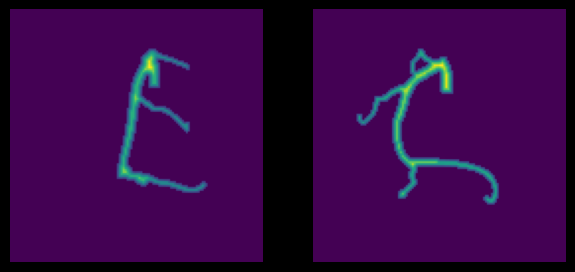

In [31]:
sample_index = 0 #random.randint(0,len(d)-1)
sample = d2[sample_index]
plt.figure(figsize=(15,15))
plt.subplot(1,4,1)
plt.imshow(sample[0][0])
plt.axis('off')
plt.subplot(1,4,2)
plt.imshow(sample[0][1])
plt.axis('off')


#Тени#

In [32]:
images, label, theta, phi = d2[sample_index]
proj1 = images[0].cpu().numpy()
proj2 = images[1].cpu().numpy()
phi1, phi2 =phi[0].item(), phi[1].item()
theta1, theta2 = theta[0].item(), theta[1].item()
# Normalize projections if needed (assuming values are in [0, 4.6] from your debug output)
if proj1.max() > 1.0:
    proj1 = proj1 / proj1.max()  # Normalize to [0, 1]
    proj2 = proj2 / proj2.max()

In [45]:

def place_projection_in_3d_with_shadow(projection, phi, theta, volume_shape=(128, 128, 128), max_z=128.0, threshold=0.3):
    D = volume_shape[0]
    
    # Бинаризуем изображение
    binary_proj = torch.tensor((projection > threshold).astype(np.float32))

    h, w = binary_proj.shape
    
    # Создаём пустой 3D volume
    vol = torch.zeros(volume_shape, dtype=torch.float32)
    
    # Центрируем проекцию в XY-плоскости на Z=0
    x0 = (D - w) // 2
    y0 = (D - h) // 2
    vol[y0:y0+h, x0:x0+w, 0] = binary_proj  # Проекция на плоскость XY при Z=0
    
    # Получаем координаты ненулевых точек
    y_coords, x_coords = torch.where(vol[:, :, 0] > 0)

    # Переводим углы в радианы
    phi_rad = torch.tensor(np.radians(phi))
    theta_rad = torch.tensor(np.radians(theta))

    # Вычисляем направления теней
    dx = torch.cos(phi_rad) * torch.cos(theta_rad)
    dy = torch.sin(phi_rad) * torch.cos(theta_rad)
    dz = torch.sin(theta_rad)  # Z-компонента

    # Нормализация вектора направления
    norm = torch.sqrt(dx**2 + dy**2 + dz**2)
    dx, dy, dz = dx / norm, dy / norm, dz / norm

    # Создаём массив возможных Z-индексов
    z_indices = torch.linspace(0, max_z, D)
    
    # Вычисляем координаты теней векторами
    shadow_x = x_coords[:, None] + dx * z_indices[None, :]
    shadow_y = y_coords[:, None] + dy * z_indices[None, :]
    shadow_z = z_indices[None, :].repeat(len(x_coords), 1)

    # Округляем координаты до индексов
    shadow_x = shadow_x.round().long().clamp(0, D - 1)
    shadow_y = shadow_y.round().long().clamp(0, D - 1)
    shadow_z = shadow_z.round().long().clamp(0, D - 1)

    # Заполняем объём тенями
    vol[shadow_y, shadow_x, shadow_z] = 1.0

    return vol

def build_3d_two_channels_with_shadow(proj1, phi1, theta1, proj2, phi2, theta2, volume_shape=(128, 128, 128), max_z=128.0, threshold=0.3):
    vol1 = place_projection_in_3d_with_shadow(proj1, phi1, theta1, volume_shape, max_z, threshold)
    vol2 = place_projection_in_3d_with_shadow(proj2, phi2, theta2, volume_shape, max_z, threshold)
    return torch.stack([vol1, vol2], dim=0)  # (2, 128, 128, 128)

# Генерируем 3D тензор с тенями
volume_2ch = build_3d_two_channels_with_shadow(proj1, phi1, theta1, proj2, phi2, theta2)


In [46]:

# Set dark theme
pio.templates.default = "plotly_dark"

# Extract channels
ch1 = volume_2ch[0]  # Channel 1 (Projection 1)
ch2 = volume_2ch[1]  # Channel 2 (Projection 2)

# Print data ranges and structure for debugging
print("Channel 1 shape:", ch1.shape)
print("Channel 1 min/max:", ch1.min(), ch1.max())
print("Channel 1 non-zero count:", np.count_nonzero(ch1))
print("Channel 2 shape:", ch2.shape)
print("Channel 2 min/max:", ch2.min(), ch2.max())
print("Channel 2 non-zero count:", np.count_nonzero(ch2))

# Get coordinates of non-zero voxels for Channel 1
coords1 = np.where(ch1 > 0)
x1, y1, z1 = coords1[0], coords1[1], coords1[2]

# Get coordinates of non-zero voxels for Channel 2
coords2 = np.where(ch2 > 0)
x2, y2, z2 = coords2[0], coords2[1], coords2[2]

# Scale coordinates to make them visible (e.g., 0 to 10)
scale_factor = 10.0 / 127.0  # Scale from 0-127 to 0-10
x1_scaled = x1 * scale_factor
y1_scaled = y1 * scale_factor
z1_scaled = z1 * scale_factor
x2_scaled = x2 * scale_factor
y2_scaled = y2 * scale_factor
z2_scaled = z2 * scale_factor

# Create a 3D scatter plot for Channel 1 (red)
scatter1 = go.Scatter3d(
    x=x1_scaled,  # Scaled X (Z in your case)
    y=y1_scaled,  # Scaled Y
    z=z1_scaled,  # Scaled Z
    mode='markers',
    marker=dict(
        size=4,  # Adjust size for visibility
        color='red',  # Red for Projection 1
        opacity=0.5  # High opacity for visibility
    ),
    name='Projection 1'
)

# Create a 3D scatter plot for Channel 2 (blue)
scatter2 = go.Scatter3d(
    x=x2_scaled,
    y=y2_scaled,
    z=z2_scaled,
    mode='markers',
    marker=dict(
        size=4,
        color='blue',  # Blue for Projection 2
        opacity=0.5
    ),
    name='Projection 2'
)

# Combine both scatters in a single figure
fig = go.Figure(data=[scatter1, scatter2])

# Update layout for better visualization, including axis limits
fig.update_layout(
    scene=dict(
        xaxis=dict(range=[0, 10], title='X'),
        yaxis=dict(range=[0, 10], title='Y'),
        zaxis=dict(range=[0, 10], title='Z')
    ),
    title='3D Visualization of Two Projections (Channels 1 & 2)',
    width=800,
    height=800,
    scene_camera=dict(
        eye=dict(x=0.5, y=1.5, z=-0.5)  # Adjust camera position for better view
    )
)

# Show the interactive plot
fig.show()

Channel 1 shape: torch.Size([128, 128, 128])
Channel 1 min/max: tensor(0.) tensor(1.)
Channel 1 non-zero count: 57103
Channel 2 shape: torch.Size([128, 128, 128])
Channel 2 min/max: tensor(0.) tensor(1.)
Channel 2 non-zero count: 46322


In [49]:

# Конвертируем тензор в numpy (если он в torch)
ch1 = volume_2ch[0].cpu().numpy()
ch2 = volume_2ch[1].cpu().numpy()

# Применяем алгоритм Marching Cubes для изоверхности
verts, faces, _, _ = skimage.measure.marching_cubes(ch1, level=0)
verts2, faces2, _, _ = skimage.measure.marching_cubes(ch2, level=0)

x, y, z = verts[:, 0], verts[:, 1], verts[:, 2]
i, j, k = faces[:, 0], faces[:, 1], faces[:, 2]

x2, y2, z2 = verts2[:, 0], verts2[:, 1], verts2[:, 2]
i2, j2, k2 = faces2[:, 0], faces2[:, 1], faces2[:, 2]

fig = go.Figure(data=[
    go.Mesh3d(x=x, y=y, z=z, i=i, j=j, k=k, opacity=1, color='steelblue'),
    go.Mesh3d(x=x2, y=y2, z=z2, i=i2, j=j2, k=k2, opacity=1, color='green')
])

fig.update_layout(
    title="3D Surface from Backprojection",
    scene=dict(xaxis_title="X", yaxis_title="Y", zaxis_title="Z"),
    width=800,
    height=800,
)

fig.show()


Работа с оригинальным тензором

In [38]:
output_3d_model = np.load(labels_dir+'/0000.npy')
output_3d_model.shape

(4, 300, 4)

In [39]:
import plotly.graph_objects as go

def create_cylinder(p0, p1, r0, r1, resolution=40):
    p0 = np.array(p0)
    p1 = np.array(p1)
    # Vector from p0 to p1
    v = p1 - p0
    v = v / np.linalg.norm(v)
    
    # Create two vectors orthogonal to v
    if (v == np.array([0, 0, 1])).all():
        ortho1 = np.array([1, 0, 0])
    else:
        ortho1 = np.cross(v, [0, 0, 1])
        ortho1 /= np.linalg.norm(ortho1)
    ortho2 = np.cross(v, ortho1)
    
    # Angles for the circle
    theta = np.linspace(0, 2 * np.pi, resolution, endpoint=False)
    
    # Create circle at p0
    circle0 = [p0 + r0 * (np.cos(t) * ortho1 + np.sin(t) * ortho2) for t in theta]
    # Create circle at p1
    circle1 = [p1 + r1 * (np.cos(t) * ortho1 + np.sin(t) * ortho2) for t in theta]
 
    # Combine vertices
    vertices = np.vstack((circle0, circle1))
    
    # Create faces
    faces = []
    for i in range(resolution):
        next_i = (i + 1) % resolution
        # Triangle 1
        faces.append((i, next_i, resolution + i))
        # Triangle 2
        faces.append((next_i, resolution + next_i, resolution + i))
    
    return vertices, faces

def create_tube(centerline, radius, resolution=40):
    all_vertices = []
    all_faces = []
    vertex_offset = 0

    for i in range(len(centerline) - 1):
        p0 = centerline[i]
        p1 = centerline[i + 1]
        r0 = radius[i]
        r1 = radius[i + 1]
        
        vertices, faces = create_cylinder(p0, p1, r0, r1, resolution)
        all_vertices.append(vertices)
        # Adjust face indices
        adjusted_faces = [(a + vertex_offset, b + vertex_offset, c + vertex_offset) for a, b, c in faces]
        all_faces.extend(adjusted_faces)
        vertex_offset += vertices.shape[0]
    
    all_vertices = np.vstack(all_vertices)
    return all_vertices, all_faces

def crop_to_content(image: torch.Tensor, alpha_threshold: float = 0.1) -> torch.Tensor:
    # Extract the alpha channel
    alpha = image[-1, :, :]

    # Create a binary mask where alpha is above the threshold
    mask = alpha > alpha_threshold

    # Find the bounding box of the content
    non_zero_indices = mask.nonzero(as_tuple=False)
    if non_zero_indices.numel() == 0:
        # If there's no content, return the original image
        return image

    y_min, x_min = non_zero_indices.min(dim=0)[0]
    y_max, x_max = non_zero_indices.max(dim=0)[0]

    # Crop the image to the bounding box
    cropped_image = image[:, y_min:y_max + 1, x_min:x_max + 1]

    return cropped_image

def render_sample(sample):
    meshes = []
    tensor_list = []

    for branch in sample:
        tensor = branch  # [x, y, z, r]
        tensor_list.append(tensor)

        centerline = branch[:, :3]
        radius = branch[:, 3]
        vertices, faces = create_tube(centerline, radius, resolution=40)

        x, y, z = vertices[:, 0], vertices[:, 1], vertices[:, 2]
        I = [face[0] for face in faces]
        J = [face[1] for face in faces]
        K = [face[2] for face in faces]

        mesh = go.Mesh3d(x=x, y=y, z=z, i=I, j=J, k=K, color='lightblue', opacity=0.6, name='Tube')
        scatter = go.Scatter3d(
            x=[point[0] for point in centerline],
            y=[point[1] for point in centerline],
            z=[point[2] for point in centerline],
            mode='lines+markers', line=dict(color='red', width=4),
            marker=dict(size=1, color='red'), name='Centerline'
        )
        meshes.append(mesh)
        meshes.append(scatter)

    combined_tensor = np.vstack(tensor_list)
    return combined_tensor, meshes


def normalize_tensor(sample):
    centerline_copy = sample.copy()
    slice = centerline_copy[...,:3]
    scale = slice.max()-slice.min()

    centerline_copy[...,:3]-=slice.min()
    centerline_copy[...,:3]/=slice.max()
    centerline_copy[...,-1]/=scale
    
    return centerline_copy 

output_3d_model = normalize_tensor(output_3d_model)
tensor, meshes = render_sample(output_3d_model)

# Визуализация (опционально)
layout = go.Layout(
    title='3D Tube Visualization',
    scene=dict(xaxis=dict(title='X'), yaxis=dict(title='Y'), zaxis=dict(title='Z'), aspectmode='data'),
    legend=dict(x=0.7, y=0.9), width=700, height=700
)
fig = go.Figure(data=meshes, layout=layout)
fig.show()

print("тензор:\n", tensor[:5])  # Первые 5 строк для примера


тензор:
 [[0.74551605 0.7721937  0.69086499 0.03427949]
 [0.73787494 0.766177   0.69898784 0.0341233 ]
 [0.73043322 0.76009437 0.70618702 0.03394279]
 [0.72318573 0.75395647 0.71249877 0.03372929]
 [0.71612731 0.74777398 0.71795934 0.03395839]]


In [40]:
output_3d_model 
output_3d_model.shape # 0 - батчи (ветки сосудов), 1 - кол.во точек, 2 - сами значения x,y,z,r

(4, 300, 4)

In [41]:
# Для всех групп
T = torch.zeros((128, 128, 128), dtype=torch.float32)

for group in range(output_3d_model.shape[0]):
    x = (output_3d_model[group, :, 0] * 128).astype(int)
    y = (output_3d_model[group, :, 1] * 128).astype(int)
    z = (output_3d_model[group, :, 2] * 128).astype(int)
    R = torch.tensor(output_3d_model[group, :, 3], dtype=torch.float32)

    for i in range(len(x)):
        #radius = int(R)
        radius = int(R[i] * 128)  # Масштабируем радиус
        if radius < 1: radius = 1
        
        for shiftx in range(-radius, radius + 1):
            for shifty in range(-radius, radius + 1):
                for shiftz in range(-radius, radius + 1):
                    new_x = x[i] + shiftx
                    new_y = y[i] + shifty
                    new_z = z[i] + shiftz
                    if (0 <= new_x < 128 and 0 <= new_y < 128 and 0 <= new_z < 128):
                        if T[new_x, new_y, new_z] == 0:
                            T[new_x, new_y, new_z] = R[i]
                        else:
                            T[new_x, new_y, new_z] = (T[new_x, new_y, new_z] + R[i]) / 2
#T = T.unsqueeze(0)


In [48]:

pio.templates.default = "plotly_dark"
plt.style.use('dark_background')
# Предположим, T уже создан (размер (128, 128, 128))
# Извлекаем координаты ненулевых элементов
nonzero_indices = T.nonzero(as_tuple=False)  # Возвращает тензор формы (кол-во ненулевых, 3)
values = T[nonzero_indices[:, 0], nonzero_indices[:, 1], nonzero_indices[:, 2]]  # Значения в этих точках

# Преобразуем в списки для Plotly
x_coords = nonzero_indices[:, 0].tolist()
y_coords = nonzero_indices[:, 1].tolist()
z_coords = nonzero_indices[:, 2].tolist()
radii = values.tolist()  # Яркость или размер точек

# Создаём 3D Scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=x_coords,
    y=y_coords,
    z=z_coords,
    mode='markers',
    marker=dict(
        size=[r * 100 for r in radii],  # Увеличиваем радиус для видимости
        color=radii,                    # Цвет зависит от значения радиуса
        colorscale='Viridis',           # Цветовая шкала
        opacity=0.8,
        colorbar=dict(title="Radius")   # Добавляем шкалу
    )
)])


# Настраиваем внешний вид
fig.update_layout(
    title="3D Visualization of Tensor T",
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Z",
        aspectmode='cube'  # Кубическая форма для равных осей   
    ), width=700, height=700
)

# Показываем график
fig.show()

In [51]:
# fig = go.Figure(data=[
#     go.Mesh3d(x=x, y=y, z=z, i=i, j=j, k=k, opacity=1, color='steelblue'),
#     go.Mesh3d(x=x2, y=y2, z=z2, i=i2, j=j2, k=k2, opacity=1, color='green')
# ])
# Конвертируем тензор в numpy (если он в torch)
ch1 = volume_2ch[0].cpu().numpy()
ch2 = volume_2ch[1].cpu().numpy()

# Применяем алгоритм Marching Cubes для изоверхности
verts, faces, _, _ = skimage.measure.marching_cubes(ch1, level=0)
verts2, faces2, _, _ = skimage.measure.marching_cubes(ch2, level=0)

x, y, z = verts[:, 0], verts[:, 1], verts[:, 2]
i, j, k = faces[:, 0], faces[:, 1], faces[:, 2]

x2, y2, z2 = verts2[:, 0], verts2[:, 1], verts2[:, 2]
i2, j2, k2 = faces2[:, 0], faces2[:, 1], faces2[:, 2]

# Настраиваем внешний вид
fig.update_layout(
    title="3D Visualization of Tensor T",
    scene=dict(
        xaxis_title="X",
        yaxis_title="Y",
        zaxis_title="Z",
        aspectmode='cube'  # Кубическая форма для равных осей   
    ), width=800, height=800
)

fig.show()

# Создаём 3D Scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=x_coords,
    y=y_coords,
    z=z_coords,
    mode='markers',
    marker=dict(
        size=[r * 100 for r in radii],  # Увеличиваем радиус для видимости
        color=radii,                    # Цвет зависит от значения радиуса
        colorscale='Viridis',           # Цветовая шкала
        opacity=0.8,
        colorbar=dict(title="Radius")   # Добавляем шкалу
    )
),
go.Mesh3d(x=x, y=y, z=z, i=i, j=j, k=k, opacity=1, color='steelblue'),
go.Mesh3d(x=x2, y=y2, z=z2, i=i2, j=j2, k=k2, opacity=1, color='green')
])





Пример того чего хотим достичь

In [ ]:
from kemsekov_torch.residual import ResidualBlock

def minmax(x):
    x-=x.min()
    x/=x.max()

V = torch.randn((4,300,4))
minmax(V[...,0])
minmax(V[...,1])
minmax(V[...,2])
minmax(V[...,3])
# V


model = torch.nn.Sequential(
    ResidualBlock(
        in_channels=2,
        out_channels=8,
        stride=2,
        dimensions=3
    ),
    ResidualBlock(
        in_channels=8,
        out_channels=16,
        stride=2,
        dimensions=3
    ),
    ResidualBlock(
        in_channels=16,
        out_channels=32,
        stride=2,
        dilation=[1]*8+[2]*8+[4]*16,
        dimensions=3
    ),
    *[ResidualBlock(
        in_channels=32,
        out_channels=[8,32],
        dimensions=3
    ) for _ in range(5)],
    ResidualBlock(
        in_channels=32,
        out_channels=16,
        stride=2,
        dimensions=3
    ).transpose(),
    ResidualBlock(
        in_channels=16,
        out_channels=8,
        stride=2,
        dimensions=3
    ).transpose(),
    ResidualBlock(
        in_channels=8,
        out_channels=1,
        stride=2,
        dimensions=3
    ).transpose(),
)

T = torch.randn((1,128,128,128))

x = 0.3
y=0.7
z=0.1
R=3

pos = int(x*128),int(y*128),int(z*128)
pos = torch.tensor([0,1,2,3,4]),torch.tensor([5,8,2,3,4]),torch.tensor([9,10,5,22,5])

for shiftx in [-1,0,1]:
    for shifty in [-1,0,1]:
        for shiftz in [-1,0,1]:
            position = [0,pos[0]+shiftx,pos[1]+shifty,pos[2]+shiftz]
            slice = T[*position]
            T[*position][slice==0]=R
            T[*position][slice!=0]+=R
            T[*position][slice!=0]/=2

# (batch_size, channels, x,y,z)
input = torch.randn((1,2,128,128,128))
correct = torch.randn((1,1,128,128,128))

torch.nn.functional.mse_loss(model(input),correct)

In [73]:
# Добавляем batch_size и channels
T = T.unsqueeze(0).unsqueeze(0)  # (1, 1, 128, 128, 128)

# Пример входных данных для модели
input = torch.randn((1, 2, 128, 128, 128))  # (batch_size, channels, x, y, z)
correct = T  # (1, 1, 128, 128, 128)

# Пример вызова функции потерь
loss = torch.nn.functional.mse_loss(model(input), correct)